## Predicting Marketing Campaign Response Using Logistic Regression

by Rabindranatah Duran Pons, Yasaman Eftekharypour, Valeria Siciliano, Rocco Lee


# Summary

In this project, we developed a machine-learning pipeline using logistic regression to predict whether a customer will subscribe to a marketing campaign. The workflow combined a preprocessing stage (StandardScaler and OneHotEncoder) with a logistic regression classifier, followed by training and evaluation using a train/test split.

After applying class-weighting to address the dataset’s imbalance, the model achieved an accuracy of approximately 85% and a ROC-AUC of ~0.91, indicating strong overall discrimination between the subscribed (“yes”) and not-subscribed (“no”) classes. Importantly, class-weighting significantly improved the model’s ability to detect positive cases, giving the “yes” class a recall of 0.81. This shows that the weighted logistic regression approach is better suited for imbalanced marketing data, where correctly identifying potential subscribers is more valuable than simply maximizing accuracy.

# Introduction

# Background:

Financial institutions frequently rely on direct marketing campaigns to promote new products and services to potential clients. One common approach is telephone-based marketing, where bank representatives call customers to inform them about financial offerings, such as long-term deposits and attempt to persuade them to subscribe. Although this method can be effective, it is also resource-intensive calling uninterested or unlikely customers wastes time, labor, and operational costs. As a result, banks increasingly turn to data-driven decision-making to identify which individuals are most likely to respond positively to a campaign.

The Bank Marketing Dataset was created within this context. Compiled by researchers at the University of Minho in Portugal, it captures detailed information from a series of telephone marketing campaigns run by a Portuguese banking institution. The dataset includes demographic attributes (such as age, employment type, and marital status), financial indicators (such as credit defaults and loan status), and campaign-specific variables (including previous contact outcomes and call duration). The target variable indicates whether a customer ultimately subscribed to a term deposit, making the dataset a classic example of a binary classification problem.

**The main question explored in this project is**:

“Can we predict whether a bank customer will subscribe to a term deposit based on their demographic characteristics, financial information, and interactions with previous marketing campaigns?”

The dataset includes three main categories of features:

1. Client demographics and personal information

- age

- job

- marital

- education

- default (has credit in default)

- housing (has housing loan)

- loan (has personal loan)

2. Current campaign interaction

- contact — type of communication (cellular/telephone)

- day_of_week — day of contact

- month — month of campaign

- duration — call duration in seconds

- campaign — number of contacts during this campaign

3. Past campaign and historical interaction

- pdays — number of days since last contact

- previous — number of previous contacts

- poutcome — outcome of previous campaign

# Methods

## Data

The dataset used in this project is the Bank Marketing Dataset, created by Moro, Cortez, and Rita (2014) at the University of Minho in Portugal. The data was sourced from the UCI Machine Learning Repository, and can be accessed online at https://archive.ics.uci.edu/dataset/222/bank+marketing. Each row in the dataset represents a single customer contacted during a direct marketing phone campaign, and includes information such as demographic attributes, financial status, call details, previous campaign interactions, and the final outcome indicating whether the customer subscribed to a term deposit.

## Analysis

A logistic regression model was used to predict whether a marketing campaign will be successful or not. All original variables from the dataset were included in the analysis. Before fitting, numerical features were standardized with a StandardScaler, and categorical variables were converted to binary indicators via OneHotEncoder. The dataset was split into 80% training and 20% testing, and class imbalance was addressed by balancing class weights during model training. The model’s performance was evaluated using accuracy and ROC-AUC scores.

The code used to perform this analysis and generate the accompanying report can be found here: https://github.com/Roccolee18/bank_marketing_group_24/blob/main/marketing_campain_predictor.ipynb

# Results & Discussion

The logistic regression model developed for this analysis provides meaningful insight into the factors associated with customer subscription, but it also highlights the intrinsic challenges of modeling imbalanced marketing data. Our pipeline combined appropriate preprocessing steps—StandardScaler for numerical features and One-Hot Encoding for categorical variables—with a LogisticRegression classifier to ensure proper handling of the heterogeneous dataset while respecting the Golden Rule and avoiding data leakage.

The performance metrics indicate that the model performs reasonably well overall. The ROC-AUC score of approximately 0.91 suggests strong ability to distinguish between subscribers (“yes”) and non-subscribers (“no”). Although overall accuracy is around 0.85, accuracy alone is not an appropriate metric for this imbalanced context, because the majority class dominates the dataset.

More importantly, the class-weighted logistic regression successfully shifts the model’s focus toward the minority class. The recall for the “yes” class reaches 0.81, a substantial improvement compared to what a non-weighted model would typically achieve on an imbalanced dataset. This indicates that the model is able to identify most customers who eventually subscribe—an outcome that aligns with the core business objective, where failing to detect potential subscribers is far more costly than incorrectly flagging non-subscribers. The precision for the “yes” class is lower (0.42), which is an expected trade-off: by increasing recall and giving more weight to positive cases, the classifier becomes more permissive and produces more false positives. However, in a marketing context—where the cost of contacting an uninterested customer is low compared to the value of identifying a true potential subscriber—this trade-off is acceptable and strategically desirable.

The confusion matrix supports this interpretation. Out of 1,058 actual subscribers, the model correctly identifies 862 true positives while misclassifying 196 as non-subscribers. On the other hand, among the majority class, 6,786 non-subscribers are correctly classified, with 1,199 false positives. These numbers reflect a deliberate shift in the decision boundary due to class balancing: the model becomes more sensitive to the minority class at the expense of increasing false positives.

Overall, the balanced logistic regression model is appropriate for this business problem. Its ability to capture a large portion of true subscribers, even with lower precision, aligns with the strategic goal of maximizing successful marketing outreach. By prioritizing recall in the positive class, the model supports proactive customer engagement and provides a meaningful foundation for future marketing campaigns.

These results show that using a class-weighted logistic regression helps the model catch many more people who are likely to subscribe. This can be useful for marketing teams because it means they can focus their efforts on customers who are more likely to say “yes.” It also shows which factors—like the success of previous campaigns, the month of contact, or call duration—matter most, which can help improve how future campaigns are planned.

These results also bring up a number of future questions. For example, it is unclear whether another type of model, such as a tree-based method, could perform even better than logistic regression on this imbalanced data. Another question is whether the same patterns would appear if we ran this analysis on a different marketing campaign or a different time period. Finally, it would be useful to understand which types of customers the model tends to misclassify most often, and whether adding more customer information could help the model make more reliable predictions.

The following code reads the data programatically and saves it to the data folder:

In [1]:
from ucimlrepo import fetch_ucirepo
import pandas as pd
import altair as alt
import os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import (
    accuracy_score, classification_report, 
    roc_auc_score, confusion_matrix
)
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data folder if it doesn't exist
os.makedirs("data", exist_ok=True)
 
# fetch dataset 
bank_marketing = fetch_ucirepo(id=222)

# Convert the data into a pd dataframe
X = bank_marketing.data.features 
y = bank_marketing.data.targets 
  
df = pd.concat([X, y], axis=1)

# Save combined dataset to data folder
df.to_csv("data/bank_marketing.csv", index=False)

print(df.shape)
print(df.head())

(45211, 17)
   age           job  marital  education default  balance housing loan  \
0   58    management  married   tertiary      no     2143     yes   no   
1   44    technician   single  secondary      no       29     yes   no   
2   33  entrepreneur  married  secondary      no        2     yes  yes   
3   47   blue-collar  married        NaN      no     1506     yes   no   
4   33           NaN   single        NaN      no        1      no   no   

  contact  day_of_week month  duration  campaign  pdays  previous poutcome   y  
0     NaN            5   may       261         1     -1         0      NaN  no  
1     NaN            5   may       151         1     -1         0      NaN  no  
2     NaN            5   may        76         1     -1         0      NaN  no  
3     NaN            5   may        92         1     -1         0      NaN  no  
4     NaN            5   may       198         1     -1         0      NaN  no  


# Data Validation

Before working on the dataset, we need to perform some validation checks to make sure that raw data meet the required format. The validation will be performed on the following points:

- Correct data file format

- Correct column names

- No empty observations

- Missingness not beyond expected threshold

- Correct data types in each column

- No duplicate observations

- No outlier or anomalous values

- Correct category levels (i.e., no string mismatches or single values)

- Target/response variable follows expected distribution (Located in the Model Fitting and Training section)

- No anomalous correlations between target/response variable and features/explanatory variables

- No anomalous correlations between features/explanatory variables

### Correct data file format 

In [2]:
from pathlib import Path
import pandera as pa
from pandera import Column, DataFrameSchema

def validate_correct_data_format(df, file_path):
    """
    Validate that the data format matches .csv.
    
    Parameters
    ----------
    df : pandas.DataFrame
        The used dataset.
    file_path : str or Path
        Path to the raw data file.

    """
    
    file_path = Path(file_path)

    if file_path.suffix.lower() != ".csv":
        raise ValueError(
            f"File format is not correct: expected '.csv', got '{file_path.suffix}'"
        )

    print("The file format validation passed: .csv file detected")
    
validate_correct_data_format(df, "data/bank_marketing.csv")


The file format validation passed: .csv file detected


### Correct column names

In [3]:
from pandera import Column, DataFrameSchema

columns = [
    "age", "job", "marital", "education", "default",
    "balance", "housing", "loan", "contact",
    "day_of_week", "month", "duration", "campaign",
    "pdays", "previous", "poutcome", "y"
]
column_schema=DataFrameSchema(
    columns={c: Column(nullable=True) for c in columns},
    strict=True,
    ordered=False
)
def column_names(df):
    """
    Validate of the correct column names.
    """
    
    column_schema.validate(df)
    print("Correct column names were passed")
    
column_names(df)

Correct column names were passed


### No empty observations

In [4]:
def no_empty_observations(df):
    """
    Validation to make sure there are no empty observations (row where all values are missing)
    """
    n_obs=df.isna().all(axis=1).sum()
    
    empty_obs=pa.DataFrameSchema(
        columns=None,
        checks=[
            pa.Check(
            lambda df: ~(df.isna().all(axis=1)).any(),
            element_wise=False,
            error="Found one or more completely empty rows in the dataset."
        )
        ])
    empty_obs.validate(df)
    print(f"{n_obs} empty observations found in dataset.")
    
no_empty_observations(df)



0 empty observations found in dataset.


### No anomalous correlations between target/response variable and features/explanatory variables

In [5]:
from deepchecks.tabular import Dataset
from deepchecks.tabular.checks import FeatureLabelCorrelation

bank_train_ds = Dataset(
    df, label="y", 
    cat_features=['job', 
                'marital', 
                'education', 
                'default', 
                'housing', 
                'loan', 
                'contact',
                'month', 
                'poutcome']
)

# Trigger a warning if any feature has a predictive power score (correlation) greater than 0.8 with the target
check_feat_lab_corr = FeatureLabelCorrelation().add_condition_feature_pps_less_than(0.8)
check_feat_lab_corr_result = check_feat_lab_corr.run(dataset=bank_train_ds)

if not check_feat_lab_corr_result.passed_conditions():
    raise ValueError("Feature-Label correlation exceeds the maximum acceptable threshold.")

/Users/rabin/miniforge3/envs/522/lib/python3.12/site-packages/deepchecks/core/serialization/dataframe/html.py:16: UserWarning:

pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.



### No anomalous correlations between features/explanatory variables

In [6]:
from deepchecks.tabular.checks import FeatureFeatureCorrelation

check_feat_feat_corr = FeatureFeatureCorrelation().add_condition_max_number_of_pairs_above_threshold(
    threshold=0.99,
)

# Run the check
check_feat_feat_corr_result = check_feat_feat_corr.run(dataset=bank_train_ds)

# Uncomment to print the actual values
#print(check_feat_feat_corr_result.value)

# Trigger a warning if features have a predictive power (correlation) greater than 0.99 between each other
if not check_feat_feat_corr_result.passed_conditions():
    raise ValueError("Feature-feature correlation exceeds the maximum acceptable threshold.")

### Missingness not beyond threshold, Correct datatypes in each column, and No duplicate observations

In [7]:
# Before validation, check actual missingness
MISSINGNESS_THRESHOLDS = {
    "age": 0.01,
    "job": 0.5,
    "marital": 0.05,
    "education": 0.05,
    "default": 0.05,
    "balance": 0.05,
    "housing": 0.05,
    "loan": 0.05,
    "contact": 0.05,
    "day_of_week": 0.05,
    "month": 0.05,
    "duration": 0.05,
    "campaign": 0.05,
    "pdays": 0.05,
    "previous": 0.05,
    "poutcome": 0.05,
    "y": 0.05,
}

COLUMN_TYPES = {
    "age": pa.Int,
    "job": pa.String,
    "marital": pa.String,
    "education": pa.String,
    "default": pa.Bool,
    "balance": pa.Int,
    "housing": pa.Bool,
    "loan": pa.Bool,
    "contact": pa.String,
    "day_of_week": pa.Int,
    "month": pa.String,
    "duration": pa.Int,
    "campaign": pa.Int,
    "pdays": pa.Int,
    "previous": pa.Int,
    "poutcome": pa.String,
    "y": pa.Bool,
}

for col in df.columns:
    missing_pct = df[col].isna().mean()
    threshold = MISSINGNESS_THRESHOLDS.get(col, 0.05)
    print(f"{col}: {missing_pct:.2%} missing (threshold: {threshold:.2%})")

age: 0.00% missing (threshold: 1.00%)
job: 0.64% missing (threshold: 50.00%)
marital: 0.00% missing (threshold: 5.00%)
education: 4.11% missing (threshold: 5.00%)
default: 0.00% missing (threshold: 5.00%)
balance: 0.00% missing (threshold: 5.00%)
housing: 0.00% missing (threshold: 5.00%)
loan: 0.00% missing (threshold: 5.00%)
contact: 28.80% missing (threshold: 5.00%)
day_of_week: 0.00% missing (threshold: 5.00%)
month: 0.00% missing (threshold: 5.00%)
duration: 0.00% missing (threshold: 5.00%)
campaign: 0.00% missing (threshold: 5.00%)
pdays: 0.00% missing (threshold: 5.00%)
previous: 0.00% missing (threshold: 5.00%)
poutcome: 81.75% missing (threshold: 5.00%)
y: 0.00% missing (threshold: 5.00%)


In [8]:
import pandera as pa
from pandera import Column, DataFrameSchema, Check

# Helper function to create column schema
def create_column_schema(col_name, col_type, threshold):
    """Create a column schema with missingness check."""
    return Column(
        col_type,  # to validates the data type
        checks=[
            Check(
                lambda s: s.isna().mean() <= threshold,
                error=f"Missing value rate exceeds {threshold:.1%}",
                element_wise=False,
                ignore_na=False
            )
        ],
        nullable=True,
        coerce=True  # Attempt to coerce to the correct type
    )

# Build schema dynamically
columns_schema = {
    col_name: create_column_schema(col_name, COLUMN_TYPES[col_name], MISSINGNESS_THRESHOLDS[col_name])
    for col_name in MISSINGNESS_THRESHOLDS.keys()
}

schema = DataFrameSchema(
    columns_schema,
    strict=True,  # Ensures only defined columns are present
    unique=None,  # Will be used for duplicate check below
    coerce=True   # Attempt to coerce types across the dataframe
)

# Validate with lazy=True to collect ALL errors
try:
    # First validate schema (types and missingness)
    validated_df = schema.validate(df, lazy=True)
    
    # Then check for duplicates
    duplicates = validated_df.duplicated()
    if duplicates.any():
        num_duplicates = duplicates.sum()
        duplicate_rows = validated_df[duplicates]
        
        print(f"✗ Found {num_duplicates} duplicate row(s):\n")
        print(duplicate_rows)
        print("\nDuplicate row indices:", duplicate_rows.index.tolist())
        
        # Optionally raise an error
        raise ValueError(f"DataFrame contains {num_duplicates} duplicate rows")
    
    print("PASSED: All validation checks passed!")
    print("- Data types are correct")
    print("- Missing value rates are within thresholds")
    print("- No duplicate rows found")
    print(f"\nValidated DataFrame shape: {validated_df.shape}")
    print(validated_df.head())
    
except pa.errors.SchemaErrors as e:
    print("ERROR: Schema validation failed with the following errors:\n")
    
    # Display a summary of all failures
    print(f"Total errors found: {len(e.failure_cases)}\n")
    
    # Check for data type errors
    if 'schema_context' in e.failure_cases.columns:
        type_errors = e.failure_cases[e.failure_cases['check'].str.contains('dtype', na=False)]
        if not type_errors.empty:
            print("Data Type Errors:")
            for _, error in type_errors.iterrows():
                print(f"  • Column '{error['column']}': {error['check']}")
            print()
    
    # Show which columns failed missingness checks
    failed_columns = e.failure_cases['column'].unique()
    missingness_failures = [col for col in failed_columns 
                           if col in MISSINGNESS_THRESHOLDS]
    
    if missingness_failures:
        print(f"Columns with missingness errors: {missingness_failures}\n")
        
        # Show detailed error information for each column
        for col in missingness_failures:
            col_errors = e.failure_cases[e.failure_cases['column'] == col]
            actual_missing = df[col].isna().mean()
            threshold = MISSINGNESS_THRESHOLDS.get(col, 0.05)
            print(f"  • {col}:")
            print(f"    - Actual missing rate: {actual_missing:.2%}")
            print(f"    - Threshold: {threshold:.2%}")
            print()
    
    # Show full error details
    print("\nFull error report:")
    print(e.failure_cases[['schema_context', 'column', 'check', 'check_number']])
    
except ValueError as e:
    # Catch duplicate row errors
    print(f"\n✗ {e}")
    
except Exception as e:
    print(f"\n✗ Unexpected error: {e}")


ERROR: Schema validation failed with the following errors:

Total errors found: 2

Columns with missingness errors: ['contact', 'poutcome']

  • contact:
    - Actual missing rate: 28.80%
    - Threshold: 5.00%

  • poutcome:
    - Actual missing rate: 81.75%
    - Threshold: 5.00%


Full error report:
  schema_context    column                            check  check_number
0         Column   contact  Missing value rate exceeds 5.0%             0
1         Column  poutcome  Missing value rate exceeds 5.0%             0


### Outlier/Anomaly Validation

In [9]:
import pandera as pa
from pandera import Column, Check, DataFrameSchema


schema = DataFrameSchema(
    {
        "age": Column(
            int,
            checks=[
                Check.in_range(0, 120, include_min=True, include_max=True),
            ],
        ),
        "job": Column(
            str,
            checks=[
                Check(lambda s: s.str.len().between(2, 50, inclusive='both'), 
                error="Job title must be between 2 and 50 characters"),
            ],
            nullable = True
        ),
        "marital": Column(
            str,
            checks=[
                Check.isin(["married", "single", "divorced"])
            ],
        ),
        "education": Column(
            str,
            checks=[
                Check.isin(["tertiary", "secondary", "primary"]),
            ],
            nullable = True
        ),
        "default": Column(
            str,
            checks=[
                Check.isin(["no", "yes"]),
            ],
        ),
        "balance": Column(
            int,
            checks=[
                Check.in_range(-100000, 1000000000000, include_min=True, include_max=True),
            ],
        ),
        "housing": Column(
            int,
            checks=[
                Check.in_range(0, 1, include_min=True, include_max=True),
            ],
        ),
        "loan": Column(
            int,
            checks=[
               Check.in_range(0, 1, include_min=True, include_max=True),
            ],
        ),
        "contact": Column(
            str,
            checks=[
                Check.isin(["cellular", "telephone"]),
            ],
            nullable = True
        ),
        "day_of_week": Column(
            int,
            checks=[
                Check.in_range(1, 31, include_min=True, include_max=True),
            ],
        ),
        "month": Column(
            str,
            checks=[
                Check.isin(["jan", "feb", "mar", "apr", "may", "jun", "jul", "aug", "sep", "oct", "nov", "dec"]),
            ],
        ),
        "duration": Column(
            int,
            checks=[
                Check.in_range(0, 21600, include_min=True, include_max=True),
            ],
        ),
        "campaign": Column(
            int,
            checks=[
                Check.in_range(1, 100, include_min=True, include_max=True),
            ],
        ),
        "pdays": Column(
            int,
            checks=[
                Check.in_range(-1, 10000, include_min=True, include_max=True),
            ],
        ),
        "previous": Column(
            int,
            checks=[
                Check.in_range(0, 10000000, include_min=True, include_max=True),
            ]
        ),
        "poutcome": Column(
            str,
            checks=[
                Check.isin(["failure", "other", "success"]),
            ],
            nullable = True
        ),
        "y": Column(
            int,
            checks=[
                Check.in_range(0, 1, include_min=True, include_max=True),
            ],
        ),
    },
    strict=True,
    coerce=True, 
)

def is_outlier_iqr(series, multiplier=1.5):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - multiplier * IQR
    upper_bound = Q3 + multiplier * IQR
    return (series < lower_bound) | (series > upper_bound)

try:
    validated_df = schema.validate(df)
    print("✓ Data validation passed!")
    print(validated_df)

except pa.errors.SchemaError as e:
        print("✗ Data validation failed!")
        print(f"\nError summary: {e}")
        print("\nDetailed failure cases:")
        print(e.failure_cases)

✗ Data validation failed!

Error summary: Error while coercing 'housing' to type int64: Could not coerce <class 'pandas.core.series.Series'> data_container into type int64:
       index failure_case
0          0          yes
1          1          yes
2          2          yes
3          3          yes
4          4           no
...      ...          ...
45206  45206           no
45207  45207           no
45208  45208           no
45209  45209           no
45210  45210           no

[45211 rows x 2 columns]

Detailed failure cases:
       index failure_case
0          0          yes
1          1          yes
2          2          yes
3          3          yes
4          4           no
...      ...          ...
45206  45206           no
45207  45207           no
45208  45208           no
45209  45209           no
45210  45210           no

[45211 rows x 2 columns]


### Correct category levels (i.e., no string mismatches or single values)

In [10]:
categorical_df = df[["job", "marital", "education", "contact", "month", "poutcome"]]

schema = DataFrameSchema(
    {
        "job": Column(
            str,
            checks=[
                Check(lambda s: s.str.len().between(2, 50, inclusive='both'), 
                error="Job title must be between 2 and 50 characters"),
            ],
            nullable = True
        ),
        "marital": Column(
            str,
            checks=[
                Check.isin(["married", "single", "divorced"])
            ],
        ),
        "education": Column(
            str,
            checks=[
                Check.isin(["tertiary", "secondary", "primary"]),
            ],
            nullable = True
        ),
        "contact": Column(
            str,
            checks=[
                Check.isin(["cellular", "telephone"]),
            ],
            nullable = True
        ),
        "month": Column(
            str,
            checks=[
                Check.isin(["jan", "feb", "mar", "apr", "may", "jun", "jul", "aug", "sep", "oct", "nov", "dec"]),
            ],
        ),
        "poutcome": Column(
            str,
            checks=[
                Check.isin(["failure", "other", "success"]),
            ],
            nullable = True
        ),
    },
    strict=True,
    coerce=True, 
)

try:
    validated_df = schema.validate(categorical_df)
    print("✓ Data validation passed!")
    print(validated_df)

except pa.errors.SchemaError as e:
        print("✗ Data validation failed!")
        print(f"\nError summary: {e}")
        print("\nDetailed failure cases:")
        print(e.failure_cases)

✓ Data validation passed!
                job   marital  education    contact month poutcome
0        management   married   tertiary        NaN   may      NaN
1        technician    single  secondary        NaN   may      NaN
2      entrepreneur   married  secondary        NaN   may      NaN
3       blue-collar   married        NaN        NaN   may      NaN
4               NaN    single        NaN        NaN   may      NaN
...             ...       ...        ...        ...   ...      ...
45206    technician   married   tertiary   cellular   nov      NaN
45207       retired  divorced    primary   cellular   nov      NaN
45208       retired   married  secondary   cellular   nov  success
45209   blue-collar   married  secondary  telephone   nov      NaN
45210  entrepreneur   married  secondary   cellular   nov    other

[45211 rows x 6 columns]


# EDA

The following code performs some preliminary EDA:

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  object
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  object
 7   loan         45211 non-null  object
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [12]:
df.describe()

,age,balance,day_of_week,duration,campaign,pdays,previous
count,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211.000000
mean,40.936210,1362.272058,15.806419,258.163080,2.763841,40.197828,0.580323
std,10.618762,3044.765829,8.322476,257.527812,3.098021,100.128746,2.303441
min,18.000000,-8019.000000,1.000000,0.000000,1.000000,-1.000000,0.000000
25%,33.000000,72.000000,8.000000,103.000000,1.000000,-1.000000,0.000000
50%,39.000000,448.000000,16.000000,180.000000,2.000000,-1.000000,0.000000
75%,48.000000,1428.000000,21.000000,319.000000,3.000000,-1.000000,0.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000,871.000000,275.000000


In [13]:
df.value_counts()

age  job          marital   education  default  balance  housing  loan  contact    day_of_week  month  duration  campaign  pdays  previous  poutcome  y  
18   student      single    primary    no        608     no       no    cellular   13           nov    210       1         93     1         success   yes    1
44   blue-collar  married   secondary  no        6491    yes      no    cellular   19           nov    126       2         174    1         failure   no     1
                                                 3060    yes      no    cellular   20           apr    87        2         151    3         failure   no     1
                                                 2979    yes      no    cellular   18           may    18        5         178    3         other     no     1
                                                 1495    yes      no    cellular   1            oct    82        1         142    1         failure   no     1
                                                   

The distribution of people who subscribed and didn't subscribe can be found below:

In [14]:
# Simplify working with large datasets in Altair
alt.data_transformers.enable('vegafusion')

alt.Chart(df).mark_bar().encode(
    y=alt.Y("y:N", title="Subscribed"),
    x=alt.X("count()", title="Count"),
    color="y:N"
)

alt.Chart(...)

A comparison of the distribution of subscribed people among age can be found below:

In [15]:
(
alt.Chart(df)
.transform_density(
    density="age",
    groupby=["y"],
    as_=["age", "density"]
)
.mark_area(opacity=0.4)
.encode(
    x=alt.X("age:Q", title="Age"),
    y=alt.Y("density:Q", title="Density"),
    color=alt.Color("y:N", title="Subscribed")
)
)

alt.Chart(...)

This shows that age can be a very good predictor for subsciption when used on its own.

In [16]:
(
alt.Chart(df)
.transform_density(
    density="balance",
    groupby=["y"],
    as_=["balance", "density"]
)
.mark_area(opacity=0.4)
.encode(
    x=alt.X("balance:Q", title="Balance"),
    y=alt.Y("density:Q", title="Density"),
    color=alt.Color("y:N", title="Subscribed")
)
.properties(title="Balance Density by Subscription Outcome")
)

alt.Chart(...)

In the plot above we can see that the distribution of balance is right skwed and it might not be a good predictor on its own for subscription. However, when considering other variables, it might be useful.

The following shows a heatmap of the correlation among all the variables:

In [17]:
numeric_cols = df.select_dtypes(include='number').columns
corr_df = df[numeric_cols].corr().stack().reset_index()
corr_df.columns = ['var1', 'var2', 'correlation']

alt.Chart(corr_df).mark_rect().encode(
    x=alt.X('var1:N', title=""),
    y=alt.Y('var2:N', title=""),
    color=alt.Color('correlation:Q', scale=alt.Scale(scheme='redblue')),
    tooltip=['var1', 'var2', 'correlation']
).properties(
    title="Correlation Matrix"
)

alt.Chart(...)

We can see that there is no multicolinearity among different variables.

In [18]:
print(df['education'].unique())
print(df['marital'].unique())

['tertiary' 'secondary' nan 'primary']
['married' 'single' 'divorced']


# Preprocessing

In [19]:
df = df.dropna()
df = df[df['education'] != 'unknown']
df = df[df['job'] != 'unknown']
df = df[df['marital'] != 'unknown']

print(df.head())
print(df.info())

       age         job  marital  education default  balance housing loan  \
24060   33      admin.  married   tertiary      no      882      no   no   
24062   42      admin.   single  secondary      no     -247     yes  yes   
24064   33    services  married  secondary      no     3444     yes   no   
24072   36  management  married   tertiary      no     2415     yes   no   
24077   36  management  married   tertiary      no        0     yes   no   

         contact  day_of_week month  duration  campaign  pdays  previous  \
24060  telephone           21   oct        39         1    151         3   
24062  telephone           21   oct       519         1    166         1   
24064  telephone           21   oct       144         1     91         4   
24072  telephone           22   oct        73         1     86         4   
24077  telephone           23   oct       140         1    143         3   

      poutcome    y  
24060  failure   no  
24062    other  yes  
24064  failure  yes 

In [20]:
# Target variable: y = "yes" or "no"
df["y"] = df["y"].map({"yes": 1, "no": 0})
df["housing"] = df["housing"].map({"yes": 1, "no": 0})
df["loan"] = df["loan"].map({"yes": 1, "no": 0})

In [21]:
# 4. Split features and target


# Identify numerical and categorical columns
numerical_cols = X.select_dtypes(include=["int64", "float64"]).columns
categorical_cols = X.select_dtypes(include=["object"]).columns

print(numerical_cols)
print(categorical_cols)

Index(['age', 'balance', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous'],
      dtype='object')
Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'poutcome'],
      dtype='object')


In [22]:
# 5. Preprocessing pipeline
numeric_transformer = Pipeline(
    steps=[
    ("scaler", StandardScaler())
])

categorical_transformer = Pipeline(
    steps=[
    ("onehot", OneHotEncoder(handle_unknown="ignore"))
])

preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numerical_cols),
        ("cat", categorical_transformer, categorical_cols)
    ]
)


# Fitting the model and making predictions

In [23]:
# 6. Build model pipeline
model = Pipeline(steps=[
    ("preprocessor", preprocessor),
    ("classifier", LogisticRegression(max_iter=1000, class_weight ="balanced"))
])


In [24]:
# 7. Train/test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

### Data Validation - Target/Response Variable Follows Expected Distribution
This test is out of order because it requires the data to be split into training and testing datasets before being ran.

In [25]:
from deepchecks.tabular.checks import LabelDrift , TrainTestFeatureDrift, MultivariateDrift
from deepchecks.tabular import Dataset, Suite

categorical_feats = ["job", "marital", "education", "contact", "month", "poutcome"]
training_dataset = Dataset(pd.concat([X_train, y_train]), label = "y", cat_features = categorical_feats)
testing_dataset = Dataset(pd.concat([X_test, y_test]), label = "y", cat_features = categorical_feats)


distribution_check = Suite(
        'Drift Detection Suite',
        LabelDrift().add_condition_drift_score_less_than(0.15),
        MultivariateDrift().add_condition_overall_drift_value_less_than(0.15)
    )

suite_result = distribution_check.run(training_dataset, testing_dataset)
has_drift = False
for check_result in suite_result.results:
    print(f"\nCheck: {check_result.get_header()}")
        
    if check_result.conditions_results:
        for condition_result in check_result.conditions_results:
            status = "✓" if condition_result.is_pass() else "❌"
            print(f"  {status} {condition_result.name}")
            if not condition_result.is_pass():
                has_drift = True
                print(f"     Details: {condition_result.details}")
    else:
        print("  No conditions set for this check")

/Users/rabin/miniforge3/envs/522/lib/python3.12/site-packages/deepchecks/tabular/dataset.py:236: UserWarning:

Dataframe index has duplicate indexes, setting index to [0,1..,n-1].

/Users/rabin/miniforge3/envs/522/lib/python3.12/site-packages/deepchecks/tabular/dataset.py:236: UserWarning:

Dataframe index has duplicate indexes, setting index to [0,1..,n-1].



/Users/rabin/miniforge3/envs/522/lib/python3.12/multiprocessing/queues.py:122: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  return _ForkingPickler.loads(res)
/Users/rabin/miniforge3/envs/522/lib/python3.12/multiprocessing/queues.py:122: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  return _ForkingPickler.loads(res)
/Users/rabin/miniforge3/envs/522/lib/python3.12/multiprocessing/queues.py:122: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using thi


Check: Label Drift
  ✓ Label drift score < 0.15

Check: Multivariate Drift
  ✓ Drift value is less than 0.15


In [26]:
# 8. Train model
model.fit(X_train, y_train)

/Users/rabin/miniforge3/envs/522/lib/python3.12/site-packages/sklearn/utils/validation.py:1406: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



,steps,"[('preprocessor', ...), ('classifier', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('num', ...), ('cat', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


Accuracy: 0.8457370341700763
ROC-AUC: 0.9079218714674134

Classification Report:
               precision    recall  f1-score   support

          no       0.97      0.85      0.91      7985
         yes       0.42      0.81      0.55      1058

    accuracy                           0.85      9043
   macro avg       0.70      0.83      0.73      9043
weighted avg       0.91      0.85      0.87      9043



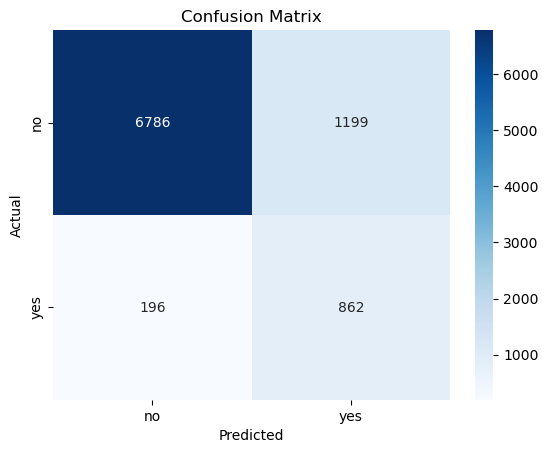

In [27]:
# 9. Predictions and evaluation
y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1]

print("Accuracy:", accuracy_score(y_test, y_pred))
print("ROC-AUC:", roc_auc_score(y_test, y_prob))
print("\nClassification Report:\n", classification_report(y_test, y_pred))

# Confusion matrix
cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, 
            annot=True, 
            fmt="d", 
            cmap="Blues", 
            xticklabels=["no", "yes"],
            yticklabels=["no", "yes"]
            )
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

              feature  importance
49   poutcome_success    1.824477
42          month_mar    1.722014
3            duration    1.525751
45          month_oct    1.276304
46          month_sep    0.984794
37          month_dec    0.713720
15        job_student    0.657311
12        job_retired    0.556467
33  contact_telephone    0.546549
32   contact_cellular    0.522132


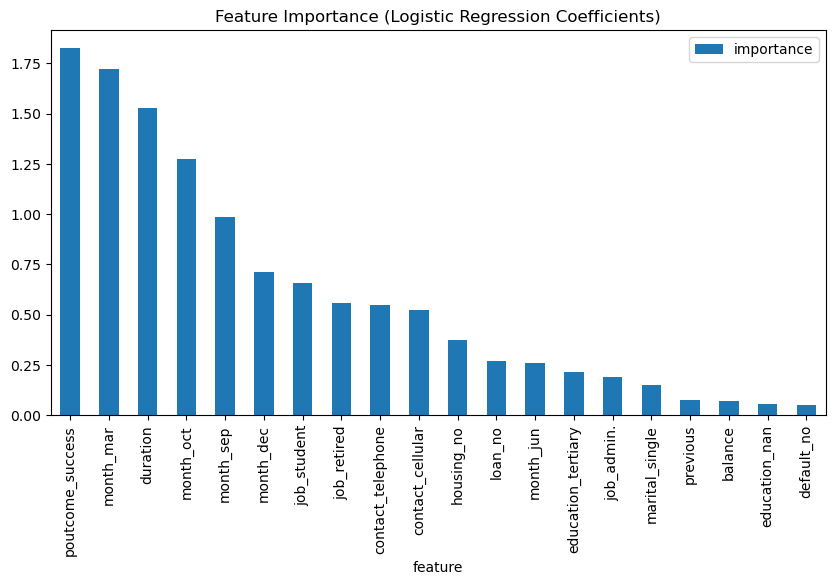

In [28]:
# 10. Feature Importance (for logistic regression)
# This is a bit tricky with pipelines — we extract processed feature names
ohe = model.named_steps["preprocessor"].named_transformers_["cat"]["onehot"]
cat_feature_names = ohe.get_feature_names_out(categorical_cols)
feature_names = np.concatenate([numerical_cols, cat_feature_names])

# Get coefficients
coeffs = model.named_steps["classifier"].coef_[0]

feat_imp = pd.DataFrame({
    "feature": feature_names,
    "importance": coeffs
}).sort_values(by="importance", ascending=False)

print(feat_imp.head(10))
feat_imp.head(20).plot(kind="bar", x="feature", y="importance", figsize=(10,5))
plt.title("Feature Importance (Logistic Regression Coefficients)")
plt.show()

# References

A data modeling approach for classification problems: application to bank telemarketing prediction
Stéphane Cédric KOUMETIO TEKOUABOU, Walid Cherif, H. Silkan
Published in International Conferences on… 27 March 2019
Computer Science, Business
https://www.semanticscholar.org/paper/A-data-modeling-approach-for-classification-to-bank-TEKOUABOU-Cherif/241d6ca92c4bc65ac3ee903e4732f70bff5c5e9f


Predicting the Accuracy for Telemarketing Process in Banks Using Data Mining
F. Alsolami, Farrukh Saleem, A. Al-malaise, AL-Ghamdi, Published 2020
Business, Computer Science
https://www.semanticscholar.org/paper/Predicting-the-Accuracy-for-Telemarketing-Process-Alsolami-Saleem/6391b7edcdd3c443bb57624b153bf9a8cca027db


Using Logistic Regression Model to Predict the Success of Bank Telemarketing
Y. Jiang, Published 21 June 2018
Business, Computer Science, Journal of data science
https://www.semanticscholar.org/paper/Using-Logistic-Regression-Model-to-Predict-the-of-Jiang/11ea58c843d0e745716d624b03067235dc285c30


Prediction of Term Deposit in Bank: Using Logistic Model Enjing Jiang, Zihao Wang, Jiaying Zhao, Published in BCP Business &amp; Management 14 December 2022
Business, Computer Science
https://www.semanticscholar.org/paper/Prediction-of-Term-Deposit-in-Bank%3A-Using-Logistic-Jiang-Wang/e36cafceaad636e9b2b558166c16be31a913ad0d
